# read csv

In [1]:
import pandas as pd

data = pd.read_csv('C:/Users/DELL/Desktop/memoire de master/restaurant1.csv',error_bad_lines=False , encoding='utf-8') #lecture de fichier csv trainT.csv
data 

,sentence,category,polarity,aspect
0,نموت علي اكل تونسي محرحر,FOOD#QUALITY,Positive,اكل
1,شعب هريسه اثبت وجود,GENERAL,Positive,"شعب,اكل"
2,انا فلسطيني بفتخر انو تونس عرب مثلي تحيه لبلد ...,GENERAL,Positive,NaN
3,والله اطيب واذكي شعب ومضياف وشعب راقي تونس بوا...,GENERAL,Positive,شعب
4,والله هذا شاب تونسي رجال وكريم وطيب و ابن ناس...,GENERAL,Positive,شاف
...,...,...,...,...
4224,مضر,RESTAURANT#cleanliness,Negative,اكل
4225,ياسر مسخ,RESTAURANT#cleanliness,Negative,مطعم
4226,ملا تبلبيز,RESTAURANT#cleanliness,Negative,اكل
4227,بنينه برشا و نظيفه انظف من محل عصريه نظيفه من ...,FOOD#QUALITY,Positive,"اكل,نظافة,عنوان,نظافة,نظافة"


In [2]:
data.loc[data.category == 'GENERAL', 'polarity'] = "Neutre"


In [3]:
#data.replace("FOOD#SERVICE", "FOOD#QUALITY", inplace=True)

In [4]:
#X= data[(data.labels == 'Positive  ')]
#X

Neutre      1707
Positive    1438
Negative    1084
Name: polarity, dtype: int64

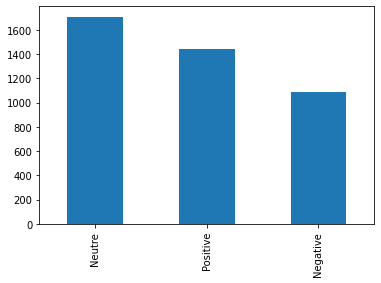

In [5]:
data.polarity.value_counts().plot.bar()
data.polarity.value_counts()

GENERAL                    1707
RESTAURANT#GENERAL         1012
FOOD#QUALITY                481
RESTAURANT#SERVICE          365
RESTAURANT#cleanliness      337
RESTAURANT#LOCALISATION     171
FOOD#PRICES                 156
Name: category, dtype: int64

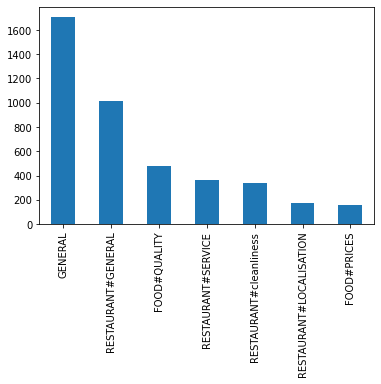

In [6]:
data.category.value_counts().plot.bar()
data.category.value_counts()

In [7]:
data

,sentence,category,polarity,aspect
0,نموت علي اكل تونسي محرحر,FOOD#QUALITY,Positive,اكل
1,شعب هريسه اثبت وجود,GENERAL,Neutre,"شعب,اكل"
2,انا فلسطيني بفتخر انو تونس عرب مثلي تحيه لبلد ...,GENERAL,Neutre,NaN
3,والله اطيب واذكي شعب ومضياف وشعب راقي تونس بوا...,GENERAL,Neutre,شعب
4,والله هذا شاب تونسي رجال وكريم وطيب و ابن ناس...,GENERAL,Neutre,شاف
...,...,...,...,...
4224,مضر,RESTAURANT#cleanliness,Negative,اكل
4225,ياسر مسخ,RESTAURANT#cleanliness,Negative,مطعم
4226,ملا تبلبيز,RESTAURANT#cleanliness,Negative,اكل
4227,بنينه برشا و نظيفه انظف من محل عصريه نظيفه من ...,FOOD#QUALITY,Positive,"اكل,نظافة,عنوان,نظافة,نظافة"


In [8]:
data['sentence']= data['sentence'].apply(str)


In [9]:
#Sentence tokenization

import nltk

sent_tokens = data.apply(lambda row: nltk.sent_tokenize(row["sentence"]), axis=1)

sent_tokens

0                              [نموت علي اكل تونسي محرحر]
1                                   [شعب هريسه اثبت وجود]
2       [انا فلسطيني بفتخر انو تونس عرب مثلي تحيه لبلد...
3       [والله اطيب واذكي شعب ومضياف وشعب راقي تونس بو...
4       [والله هذا شاب تونسي رجال  وكريم وطيب و ابن نا...
                              ...                        
4224                                                [مضر]
4225                                           [ياسر مسخ]
4226                                         [ملا تبلبيز]
4227    [بنينه برشا و نظيفه انظف من محل عصريه نظيفه من...
4228    [بنينه برشا و نظيفه انظف من محل عصريه نظيفه من...
Length: 4229, dtype: object

In [10]:
len(sent_tokens)

4229

In [11]:
#Merging into a single document for data cleaning

import itertools

doc_complete = list(itertools.chain.from_iterable(list(sent_tokens)))

doc_complete

['نموت علي اكل تونسي محرحر',
 'شعب هريسه اثبت وجود',
 'انا فلسطيني بفتخر انو تونس عرب مثلي تحيه لبلد رائع فوق راسي انتو',
 'والله اطيب واذكي شعب ومضياف وشعب راقي تونس بوابه اور والله اني مشتاق لبلابى في برد هذا',
 'والله هذا شاب تونسي رجال  وكريم وطيب و ابن ناس واهله طيب وحبوب وكرماء من مدينه منوره و اتشرف فيهم وبضيافت عندي في بيت واكل و شرب و مواصل من اول ما يوصل الين مغادره  وعين لحاف والله',
 'كل جزائري يعتبر ان تونس بلاد تاتي و لي هدا كي كانت تونس تعاني من ارهاب لقت غير جزائري لي دهب و كلهم لي تونس لي يحسو سياحه و لي يعط ضرص الي ارهابي ان جزائري لا يقبل ان تتعدو علي تونسا',
 'اكل تونسي طيب مثل ناس يدخلو قلب  كل الحب من جزائر',
 'من جزائر والله اعرف تونس من اجمل دول عربيه و عند حضاره تاريخ عمر قيروان قرطاج جامع زيتونه مسجد عقب ابن نافع و سيدي بوسعيد و حمام و سوسا و نابل  والله لكان بلاد عربيه احسن من تونس ولا ننسا جربا ملديف عرب',
 'اكل تونسي بنين يقتل اعلمت جارتي كريمه طبخ ملوخيه ولا اروع تهبل نموت عليها والله شهيتو بصحت والف تحيه شعب تونسي',
 'انا من يمن و بعمري ما زرت تونس ولكن ا

In [12]:
#Cleaning data

import string
from nltk.stem import WordNetLemmatizer 
import gensim
from nltk.stem import PorterStemmer 
from nltk.tokenize import word_tokenize 
   
ps = PorterStemmer() 
lemmatizer = WordNetLemmatizer()

stop = ['،','ء','ءَ','آ','آ','ء','آه','أبدا','أبو','ألف',"اذا",'أنت',
         'أنت','إلى','اليوم','وهو']

def clean(doc):
    stop_free = " ".join([i for i in doc.lower().split() if i not in stop])
    lemmatized = ''.join(lemmatizer.lemmatize(word) for word in stop_free)
    stemmed = ''.join(ps.stem(lemma) for lemma in lemmatized)

    return stemmed

data_clean = [clean(doc).split() for doc in doc_complete]

C:\Users\DELL\anaconda3\envs\new_en\lib\site-packages\gensim\similarities\__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


In [13]:
data_clean

[['نموت', 'علي', 'اكل', 'تونسي', 'محرحر'],
 ['شعب', 'هريسه', 'اثبت', 'وجود'],
 ['انا',
  'فلسطيني',
  'بفتخر',
  'انو',
  'تونس',
  'عرب',
  'مثلي',
  'تحيه',
  'لبلد',
  'رائع',
  'فوق',
  'راسي',
  'انتو'],
 ['والله',
  'اطيب',
  'واذكي',
  'شعب',
  'ومضياف',
  'وشعب',
  'راقي',
  'تونس',
  'بوابه',
  'اور',
  'والله',
  'اني',
  'مشتاق',
  'لبلابى',
  'في',
  'برد',
  'هذا'],
 ['والله',
  'هذا',
  'شاب',
  'تونسي',
  'رجال',
  'وكريم',
  'وطيب',
  'و',
  'ابن',
  'ناس',
  'واهله',
  'طيب',
  'وحبوب',
  'وكرماء',
  'من',
  'مدينه',
  'منوره',
  'و',
  'اتشرف',
  'فيهم',
  'وبضيافت',
  'عندي',
  'في',
  'بيت',
  'واكل',
  'و',
  'شرب',
  'و',
  'مواصل',
  'من',
  'اول',
  'ما',
  'يوصل',
  'الين',
  'مغادره',
  'وعين',
  'لحاف',
  'والله'],
 ['كل',
  'جزائري',
  'يعتبر',
  'ان',
  'تونس',
  'بلاد',
  'تاتي',
  'و',
  'لي',
  'هدا',
  'كي',
  'كانت',
  'تونس',
  'تعاني',
  'من',
  'ارهاب',
  'لقت',
  'غير',
  'جزائري',
  'لي',
  'دهب',
  'و',
  'كلهم',
  'لي',
  'تونس',
  'لي',
  'يحسو

In [14]:

import itertools

words = list(itertools.chain.from_iterable(data_clean))

#Finding POS

pos = nltk.pos_tag(words)

pos = dict(pos)

data_final=[]
sent = []

for sentence in data_clean:
    words=[]
    for term in sentence:
        #sent = sentence
        if pos[term] not in ['CC','DT','EX','IN','MD','PRP','PRP$','RP','TO','UH','WDT','WP','WRB']:
            words.append(term)
    data_final.append(words)

In [15]:
len(data_final)

4229

In [16]:
count = 0
final_data = []
for l in data_final:
    if l:
        #print(data_final.index(l))
        final_data.append(l)
        count=count+1
    else:
        print(count)
        count=count+1
          

In [17]:
len(final_data)

4229

In [18]:
#Merging into a single document for data cleaning


In [19]:
#terms_df.terms.to_csv("term.csv")

#### Averaging the Word2Vec Embeddings for each records

In [20]:
from gensim import models
model_w2v = models.Word2Vec(final_data, vector_size=300, window=5, min_count=1, workers=4)
model_w2v.save("word2vec2.model")
model_w2v.wv.key_to_index
model_w2v.wv.key_to_index

{'و': 0,
 'في': 1,
 'من': 2,
 'تونس': 3,
 'الله': 4,
 'علي': 5,
 'ربي': 6,
 'ما': 7,
 'اكل': 8,
 'ههه': 9,
 'انا': 10,
 'يا': 11,
 'تونسي': 12,
 'هذا': 13,
 'تحيه': 14,
 'الي': 15,
 'كل': 16,
 'والله': 17,
 'لا': 18,
 'جزائر': 19,
 'عند': 20,
 'ان': 21,
 'مع': 22,
 'بيض': 23,
 'كفتاجي': 24,
 'ناس': 25,
 'صحه': 26,
 'كسكروت': 27,
 'اما': 28,
 'ماكله': 29,
 'عجه': 30,
 'كان': 31,
 'شعب': 32,
 'برشا': 33,
 'وين': 34,
 'توانسه': 35,
 'تونسيه': 36,
 'لي': 37,
 'مطعم': 38,
 'شاء': 39,
 'هريسه': 40,
 'مغرب': 41,
 'حتي': 42,
 'فيه': 43,
 'لتونس': 44,
 'ولا': 45,
 'او': 46,
 'غير': 47,
 'نظافه': 48,
 'بلاد': 49,
 'فيديو': 50,
 'حاجه': 51,
 'مش': 52,
 'فيها': 53,
 'بنين': 54,
 'خويا': 55,
 'كي': 56,
 'هو': 57,
 'بعد': 58,
 'واحد': 59,
 'سرد': 60,
 'كيف': 61,
 'اهل': 62,
 'اكله': 63,
 'تحياتي': 64,
 'مره': 65,
 'خير': 66,
 'اخو': 67,
 'سندويتش': 68,
 'طيب': 69,
 'هي': 70,
 'موش': 71,
 'احلي': 72,
 'شي': 73,
 'عندو': 74,
 'نحب': 75,
 'عليه': 76,
 'جدا': 77,
 'مرحبا': 78,
 'ماشاء': 79,
 'زيت': 80,


In [21]:
import numpy as np

num_features=300

def make_feature_vec(words, model, num_features):
    
    #Average the word vectors for a set of words
   
    feature_vec = np.zeros((num_features,),dtype="float32")  # pre-initialize (for speed)
    nwords = 0
    index2word_set = set(model.wv.index_to_key)  # words known to the model

    for word in words:
        if word in index2word_set: 
            nwords = nwords + 1
            feature_vec = np.add(feature_vec,model.wv[word])
    
    feature_vec = np.divide(feature_vec, nwords)
    return feature_vec


def get_avg_feature_vecs(sentences, model, num_features):
   
    #Calculate average feature vectors for all reviews
   
    counter = 0
    mbti_feature_vecs = np.zeros((len(sentences),num_features), dtype='float32')  # pre-initialize (for speed)
    
    for sentence in sentences:
        mbti_feature_vecs[counter] = make_feature_vec(sentence, model, num_features)
        counter = counter + 1
    return mbti_feature_vecs

In [22]:
DataVecs = get_avg_feature_vecs(final_data, model_w2v, num_features)

In [23]:
len(DataVecs)

4229

In [24]:
final_data[4]

['والله',
 'هذا',
 'شاب',
 'تونسي',
 'رجال',
 'وكريم',
 'وطيب',
 'و',
 'ابن',
 'ناس',
 'واهله',
 'طيب',
 'وحبوب',
 'وكرماء',
 'من',
 'مدينه',
 'منوره',
 'و',
 'اتشرف',
 'فيهم',
 'وبضيافت',
 'عندي',
 'في',
 'بيت',
 'واكل',
 'و',
 'شرب',
 'و',
 'مواصل',
 'من',
 'اول',
 'ما',
 'يوصل',
 'الين',
 'مغادره',
 'وعين',
 'لحاف',
 'والله']

In [25]:
DataVecs[4]

array([ 2.86923200e-02,  1.42528176e-01,  3.92121039e-02,  7.90039375e-02,
        1.65597051e-02, -1.78625807e-01,  1.53179646e-01,  3.60412985e-01,
        7.76665509e-02, -7.86405653e-02,  6.21402822e-02, -1.22841194e-01,
       -7.53560588e-02,  4.99585792e-02, -1.55871004e-01, -8.15174952e-02,
        9.76064354e-02,  3.42057599e-03,  5.34267537e-02, -1.09629467e-01,
       -1.01854414e-01, -8.41622576e-02,  5.11459410e-02,  7.64576420e-02,
        1.06425889e-01, -1.74362250e-02, -1.59738749e-01, -2.19461115e-04,
       -9.18891132e-02, -1.88017711e-01,  5.69327995e-02, -1.78211536e-02,
        6.43006712e-02,  4.83297650e-03, -6.15495332e-02,  8.31667408e-02,
        2.20335666e-02, -2.00165376e-01, -4.71760742e-02,  2.35113595e-02,
       -4.51341569e-02,  3.21019962e-02,  7.36290663e-02, -1.11079365e-01,
        1.25283375e-01,  1.27720445e-01,  2.67907921e-02,  4.25744057e-02,
       -1.54365897e-02,  1.80014178e-01,  2.92444266e-02,  1.34206144e-02,
       -1.11860916e-01,  

In [26]:
count = 0

for vec in DataVecs:
    if not np.any(np.isnan(vec)):
        count=count+1
    else:
        print(count)
        count=count+1

In [27]:
data["category"] = data["category"].astype('category')

data["category_cat"] = data["category"].cat.codes

data

,sentence,category,polarity,aspect,category_cat
0,نموت علي اكل تونسي محرحر,FOOD#QUALITY,Positive,اكل,1
1,شعب هريسه اثبت وجود,GENERAL,Neutre,"شعب,اكل",2
2,انا فلسطيني بفتخر انو تونس عرب مثلي تحيه لبلد ...,GENERAL,Neutre,NaN,2
3,والله اطيب واذكي شعب ومضياف وشعب راقي تونس بوا...,GENERAL,Neutre,شعب,2
4,والله هذا شاب تونسي رجال وكريم وطيب و ابن ناس...,GENERAL,Neutre,شاف,2
...,...,...,...,...,...
4224,مضر,RESTAURANT#cleanliness,Negative,اكل,6
4225,ياسر مسخ,RESTAURANT#cleanliness,Negative,مطعم,6
4226,ملا تبلبيز,RESTAURANT#cleanliness,Negative,اكل,6
4227,بنينه برشا و نظيفه انظف من محل عصريه نظيفه من ...,FOOD#QUALITY,Positive,"اكل,نظافة,عنوان,نظافة,نظافة",1


In [28]:
data["polarity"] = data["polarity"].astype('category')

data["labels_cat"] = data["polarity"].cat.codes

data.head()

,sentence,category,polarity,aspect,category_cat,labels_cat
0,نموت علي اكل تونسي محرحر,FOOD#QUALITY,Positive,اكل,1,2
1,شعب هريسه اثبت وجود,GENERAL,Neutre,"شعب,اكل",2,1
2,انا فلسطيني بفتخر انو تونس عرب مثلي تحيه لبلد ...,GENERAL,Neutre,NaN,2,1
3,والله اطيب واذكي شعب ومضياف وشعب راقي تونس بوا...,GENERAL,Neutre,شعب,2,1
4,والله هذا شاب تونسي رجال وكريم وطيب و ابن ناس...,GENERAL,Neutre,شاف,2,1


In [29]:
data["category_cat"] = data["category_cat"].astype('category')

In [30]:
data["category_cat"].shape

(4229,)

In [31]:
data["labels_cat"] = data["labels_cat"].astype('category')

In [32]:
data["labels_cat"].shape

(4229,)

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

X_w2v = DataVecs
polarity1 =  data["labels_cat"]

In [34]:
#data.to_csv("restaurant.csv")

In [35]:
X_w2v

array([[ 0.03770846,  0.19329786,  0.05263302, ..., -0.05378928,
         0.14513287, -0.04392246],
       [ 0.02000855,  0.09466245,  0.0275414 , ..., -0.02499775,
         0.07157188, -0.02223168],
       [ 0.01435768,  0.0722776 ,  0.01942688, ..., -0.019234  ,
         0.05437316, -0.01619734],
       ...,
       [ 0.01059088,  0.0470662 ,  0.01178823, ..., -0.01572812,
         0.03645194, -0.01229062],
       [ 0.0287977 ,  0.14227453,  0.03929535, ..., -0.03848293,
         0.10756363, -0.03207976],
       [ 0.0287977 ,  0.14227453,  0.03929535, ..., -0.03848293,
         0.10756363, -0.03207976]], dtype=float32)

In [36]:
data.sentence.shape

(4229,)

In [37]:
X_w2v.shape

(4229, 300)

In [38]:
polarity1.shape

(4229,)

In [39]:
#polarity = polarity.drop(polarity.index[[20]])

In [40]:

#Y = mbti_preprocessed['I-E']
# split data into train and test sets
seed = 7
test_size = 0.20


X_train_w2v, X_test_w2v, y_train_polarity, y_test_polarity = train_test_split(X_w2v, polarity1, test_size=test_size, random_state=seed)


In [41]:
from sklearn import svm

svm_model = svm.SVC(kernel = 'linear',probability=True)
#y_train_polarity = y_train_polarity.astype(np.int8)


In [42]:

svm_model.fit(X_train_w2v,y_train_polarity)


SVC(kernel='linear', probability=True)

In [43]:

svm_pred_w2v_polarity = svm_model.predict(X_test_w2v)
# evaluate predictions
svm_accuracy_w2v_polarity = accuracy_score(y_test_polarity, svm_pred_w2v_polarity)
print(svm_accuracy_w2v_polarity)

0.39243498817966904


In [44]:
#np.unique(y_train_polarity)

In [45]:
#!pip install scikit-plot

C:\Users\DELL\anaconda3\envs\new_en\lib\site-packages\sklearn\utils\deprecation.py:86: FutureWarning: Function plot_confusion_matrix is deprecated; This will be removed in v0.4.0. Please use scikitplot.metrics.plot_confusion_matrix instead.
  warnings.warn(msg, category=FutureWarning)


([<matplotlib.axis.YTick at 0x2c0c4325e88>,
 [Text(0, 0, 'negative'), Text(0, 1, 'neutre'), Text(0, 2, 'positive')])

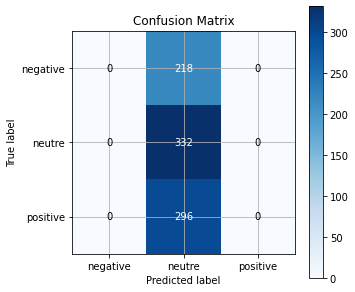

In [46]:
import scikitplot.plotters as skplt
import matplotlib.pyplot as plt
%matplotlib inline

skplt.plot_confusion_matrix(y_test_polarity, svm_pred_w2v_polarity,figsize=(5,5))

plt.xticks([0,1,2],['negative','neutre','positive'])
plt.yticks([0,1,2],['negative','neutre','positive'])

In [47]:
from sklearn.metrics import classification_report
print (classification_report(y_test_polarity, svm_pred_w2v_polarity))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       218
           1       0.39      1.00      0.56       332
           2       0.00      0.00      0.00       296

    accuracy                           0.39       846
   macro avg       0.13      0.33      0.19       846
weighted avg       0.15      0.39      0.22       846



C:\Users\DELL\anaconda3\envs\new_en\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\DELL\anaconda3\envs\new_en\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\DELL\anaconda3\envs\new_en\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [48]:
corpus = []
for doc in data_clean:
    document = ' '.join(doc)
    corpus.append(document)
    document=[]

In [49]:
corpus

['نموت علي اكل تونسي محرحر',
 'شعب هريسه اثبت وجود',
 'انا فلسطيني بفتخر انو تونس عرب مثلي تحيه لبلد رائع فوق راسي انتو',
 'والله اطيب واذكي شعب ومضياف وشعب راقي تونس بوابه اور والله اني مشتاق لبلابى في برد هذا',
 'والله هذا شاب تونسي رجال وكريم وطيب و ابن ناس واهله طيب وحبوب وكرماء من مدينه منوره و اتشرف فيهم وبضيافت عندي في بيت واكل و شرب و مواصل من اول ما يوصل الين مغادره وعين لحاف والله',
 'كل جزائري يعتبر ان تونس بلاد تاتي و لي هدا كي كانت تونس تعاني من ارهاب لقت غير جزائري لي دهب و كلهم لي تونس لي يحسو سياحه و لي يعط ضرص الي ارهابي ان جزائري لا يقبل ان تتعدو علي تونسا',
 'اكل تونسي طيب مثل ناس يدخلو قلب كل الحب من جزائر',
 'من جزائر والله اعرف تونس من اجمل دول عربيه و عند حضاره تاريخ عمر قيروان قرطاج جامع زيتونه مسجد عقب ابن نافع و سيدي بوسعيد و حمام و سوسا و نابل والله لكان بلاد عربيه احسن من تونس ولا ننسا جربا ملديف عرب',
 'اكل تونسي بنين يقتل اعلمت جارتي كريمه طبخ ملوخيه ولا اروع تهبل نموت عليها والله شهيتو بصحت والف تحيه شعب تونسي',
 'انا من يمن و بعمري ما زرت تونس ولكن اعشق 

In [50]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer()
X_predcat = vectorizer.fit_transform(corpus)
print(vectorizer.get_feature_names())
print(X_predcat.shape)


['00000', '0041', '035', '039كل', '0650', '0840', '10', '100', '1000', '10000', '105', '10اجب', '10سنو', '11', '12', '120', '1200', '13560', '139', '1400', '15', '1500', '15000', '15000د', '16', '160', '1600', '1800', '1985', '1990', '1997', '20', '2000', '2001', '2004', '2006اخو', '2007', '200k', '2010', '2011', '2015', '2019', '2020', '2021', '20سنه', '25', '250', '2500', '255', '26', '26دينار', '2لابلاك', '30', '300', '30د', '30دينار', '310يحشو', '31سنه', '35', '35د', '3ايام', '3لابراس', '400', '40كم', '45', '4500', '4كعب', '50', '500', '5000', '501', '55', '5500', '5دق', '5نجوم', '5ومانسيتش', '60', '600', '617', '647', '650', '6500', '655', '6حب', '6سن', '6كيلو', '70', '700', '7000', '80', '816', '90', '900', '936', 'rمطاعم', 'se', 'ءي', 'ئرف', 'ئلب', 'ئلبي', 'ئي', 'اانتبهتل', 'اب', 'ابابا', 'ابارك', 'اباركلك', 'ابان', 'ابتسامه', 'ابتكار', 'ابتهال', 'ابجدي', 'ابحاث', 'ابحث', 'ابد', 'ابدا', 'ابداع', 'ابدي', 'ابسط', 'ابصراحه', 'ابض', 'ابطال', 'ابطه', 'ابعاد', 'ابعتلي', 'ابعث', 'ابعد'

In [121]:
import pickle
pickle.dump(X_predcat, open('tokenizer.pickle', 'wb'))

pickled_model1 = pickle.load(open('tokenizer.pickle', 'rb'))
pickled_model1

<4229x11574 sparse matrix of type '<class 'numpy.float64'>'
	with 45398 stored elements in Compressed Sparse Row format>

In [51]:
Y_predcat1 = data['category_cat']

In [52]:
Y_predcat1.shape

(4229,)

In [53]:
#Y_predcat1= Y_predcat1.drop(polarity1.index[[20]])

In [62]:
#Y = mbti_preprocessed['I-E']
# split data into train and test sets
seed = 7
test_size = 0.20
X_train, X_test, y_train, y_test = train_test_split(X_predcat, Y_predcat1, test_size=test_size, random_state=seed)

from sklearn import svm

model = svm.SVC(kernel = 'linear',probability=True)
model.fit(X_train,y_train)
svm_pred = model.predict(X_test)
# evaluate predictions
accuracy = accuracy_score(y_test, svm_pred)
print(accuracy)

0.6182033096926713


In [122]:
# save the model to disk
filename = 'finalized_model.sav'
pickle.dump(model, open(filename, 'wb'))
 
# some time later...
 
# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))
result = loaded_model.score(X_test, y_test)
print(result)

0.6182033096926713


In [63]:
import pickle
pickle.dump(model, open('asp.pickle', 'wb'))


In [64]:
pickled_model = pickle.load(open('asp.pickle', 'rb'))
pickled_model.predict(X_test)

array([2, 5, 3, 2, 2, 2, 2, 2, 3, 2, 2, 2, 3, 6, 2, 3, 6, 2, 2, 3, 2, 3,
       3, 3, 1, 6, 2, 5, 2, 3, 2, 2, 2, 3, 3, 6, 2, 2, 2, 0, 3, 2, 3, 2,
       2, 2, 3, 2, 2, 2, 1, 2, 2, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 6, 3,
       2, 2, 3, 0, 3, 2, 2, 2, 5, 2, 3, 2, 2, 6, 2, 6, 1, 2, 2, 2, 2, 3,
       2, 3, 3, 2, 2, 3, 3, 2, 2, 3, 5, 3, 2, 2, 3, 2, 2, 2, 2, 3, 3, 2,
       2, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 2, 5, 3, 1, 2, 2, 3, 3,
       3, 3, 2, 3, 2, 2, 6, 2, 4, 2, 2, 2, 2, 3, 2, 2, 0, 0, 2, 2, 6, 2,
       3, 3, 2, 2, 2, 2, 4, 3, 2, 2, 2, 2, 2, 2, 4, 2, 2, 3, 2, 2, 5, 2,
       2, 2, 2, 2, 3, 1, 2, 2, 2, 2, 2, 4, 2, 3, 2, 3, 3, 2, 6, 1, 2, 4,
       2, 1, 2, 2, 2, 2, 2, 6, 2, 2, 2, 2, 2, 2, 2, 5, 3, 5, 3, 2, 2, 2,
       2, 2, 0, 2, 3, 2, 3, 1, 3, 2, 2, 2, 1, 2, 2, 2, 2, 1, 3, 0, 2, 5,
       2, 3, 2, 2, 2, 1, 2, 5, 3, 3, 2, 2, 3, 1, 0, 3, 2, 2, 5, 2, 2, 3,
       1, 2, 2, 1, 3, 2, 3, 1, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 6, 2,
       2, 2, 2, 4, 5, 2, 2, 1, 2, 2, 2, 2, 3, 4, 0,

In [65]:
from sklearn.metrics import classification_report
print (classification_report(y_test, svm_pred))

              precision    recall  f1-score   support

           0       0.56      0.38      0.45        24
           1       0.50      0.24      0.33        94
           2       0.60      0.91      0.73       332
           3       0.57      0.47      0.51       219
           4       0.84      0.53      0.65        30
           5       0.78      0.48      0.60        81
           6       0.85      0.50      0.63        66

    accuracy                           0.62       846
   macro avg       0.67      0.50      0.56       846
weighted avg       0.63      0.62      0.60       846



C:\Users\DELL\anaconda3\envs\new_en\lib\site-packages\sklearn\utils\deprecation.py:86: FutureWarning: Function plot_confusion_matrix is deprecated; This will be removed in v0.4.0. Please use scikitplot.metrics.plot_confusion_matrix instead.
  warnings.warn(msg, category=FutureWarning)


([<matplotlib.axis.YTick at 0x2c0ce526cc8>,
 [Text(0, 0, 'GENERAL'),
  Text(0, 1, 'FOOD#QUALITY'),
  Text(0, 2, 'FOOD#PRICES'),
  Text(0, 3, 'RESTAURANT#GENERAL'),
  Text(0, 4, 'RESTAURANT#SERVICE'),
  Text(0, 5, 'RESTAURANT#LOCALISATION'),
  Text(0, 6, 'RESTAURANT#GENERAL'),
  Text(0, 7, 'RESTAURANT#cleanliness')])

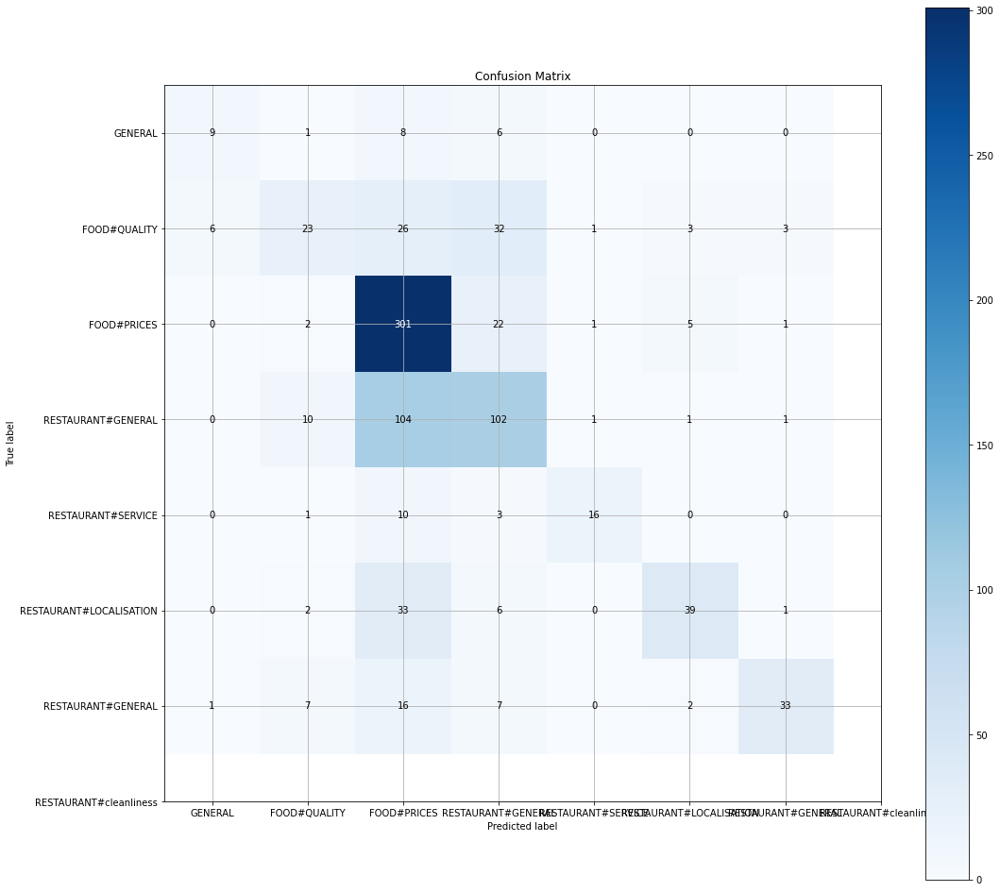

In [66]:
skplt.plot_confusion_matrix(y_test, svm_pred,figsize=(17,17))

plt.xticks([0,1,2,3,4,5,6,7],['GENERAL','FOOD#QUALITY','FOOD#PRICES','RESTAURANT#GENERAL','RESTAURANT#SERVICE','RESTAURANT#LOCALISATION','RESTAURANT#GENERAL','RESTAURANT#cleanliness'])
plt.yticks([0,1,2,3,4,5,6,7],['GENERAL','FOOD#QUALITY','FOOD#PRICES','RESTAURANT#GENERAL','RESTAURANT#SERVICE','RESTAURANT#LOCALISATION','RESTAURANT#GENERAL','RESTAURANT#cleanliness'])


In [67]:
X_train

<3383x11574 sparse matrix of type '<class 'numpy.float64'>'
	with 36592 stored elements in Compressed Sparse Row format>

In [68]:
y_train_polarity

4062    2
1114    2
3359    2
547     1
1122    2
       ..
1372    1
919     2
2550    0
537     1
1220    2
Name: labels_cat, Length: 3383, dtype: category
Categories (3, int64): [0, 1, 2]

In [69]:
#y_train_polarity= y_train_polarity.drop(polarity.index[[20]])

In [70]:
#Model building for Polarity Prediction using TF-IDF

svm_model.fit(X_train,y_train_polarity)
svm_pred_polarity = svm_model.predict(X_test)
# evaluate predictions
svm_accuracy_polarity = accuracy_score(y_test_polarity, svm_pred_polarity)
print(svm_accuracy_polarity)

0.66548463356974


In [126]:
# save the model to disk
filename = 'finalized_model1.sav'
pickle.dump(svm_model, open(filename, 'wb'))
 
# some time later...
 
# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))
result = loaded_model.score(X_test,y_test_polarity)
print(result)

0.66548463356974


In [71]:
import pickle
pickle.dump(svm_model, open('sent.pickle', 'wb'))
pickled_model = pickle.load(open('sent.pickle', 'rb'))
pickled_model.predict(X_test)

array([1, 2, 0, 1, 1, 1, 1, 1, 2, 1, 1, 1, 0, 0, 1, 0, 0, 1, 2, 0, 1, 0,
       2, 0, 0, 2, 1, 2, 0, 2, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0,
       0, 1, 2, 2, 1, 1, 0, 1, 1, 1, 1, 2, 2, 2, 0, 0, 1, 2, 1, 1, 2, 0,
       1, 1, 0, 0, 0, 1, 1, 1, 2, 1, 0, 1, 1, 0, 1, 0, 2, 1, 1, 1, 1, 0,
       1, 0, 0, 1, 1, 2, 0, 1, 1, 0, 2, 2, 1, 2, 2, 1, 0, 1, 1, 0, 2, 0,
       1, 1, 2, 1, 0, 2, 1, 1, 1, 2, 0, 1, 1, 0, 1, 2, 0, 2, 1, 1, 2, 2,
       0, 2, 2, 2, 1, 1, 0, 1, 2, 1, 1, 2, 1, 2, 1, 2, 0, 2, 1, 1, 0, 1,
       0, 2, 1, 1, 1, 0, 2, 0, 1, 2, 1, 1, 1, 2, 2, 1, 1, 0, 1, 1, 2, 2,
       1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 1, 0, 1, 2, 0, 1, 0, 2, 1, 2,
       1, 2, 1, 1, 1, 1, 1, 0, 1, 1, 1, 2, 1, 1, 1, 2, 0, 2, 2, 1, 1, 0,
       1, 1, 0, 0, 2, 1, 2, 0, 2, 1, 1, 2, 2, 2, 1, 1, 0, 1, 0, 0, 1, 2,
       1, 0, 1, 0, 1, 2, 1, 2, 2, 0, 1, 1, 2, 2, 1, 2, 1, 1, 2, 1, 1, 0,
       0, 1, 1, 0, 2, 2, 2, 2, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 2, 2, 0, 1,
       1, 2, 1, 2, 2, 1, 1, 2, 0, 1, 1, 1, 0, 2, 0,

In [72]:
X_train.shape

(3383, 11574)

In [73]:
y_train_polarity.shape

(3383,)

C:\Users\DELL\anaconda3\envs\new_en\lib\site-packages\sklearn\utils\deprecation.py:86: FutureWarning: Function plot_confusion_matrix is deprecated; This will be removed in v0.4.0. Please use scikitplot.metrics.plot_confusion_matrix instead.
  warnings.warn(msg, category=FutureWarning)


([<matplotlib.axis.YTick at 0x2c0ca0198c8>,
 [Text(0, 0, 'negative'), Text(0, 1, 'neutre'), Text(0, 2, 'positive')])

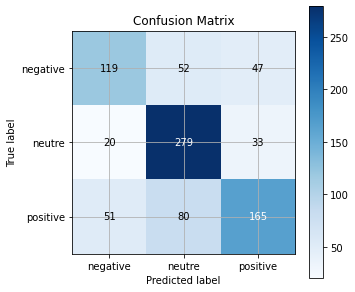

In [74]:
import scikitplot.plotters as skplt
import matplotlib.pyplot as plt
%matplotlib inline

skplt.plot_confusion_matrix(y_test_polarity, svm_pred_polarity,figsize=(5,5))

plt.xticks([0,1,2],['negative','neutre','positive'])
plt.yticks([0,1,2],['negative','neutre','positive'])


In [75]:
from sklearn.metrics import classification_report
print (classification_report(y_test_polarity, svm_pred_polarity))

              precision    recall  f1-score   support

           0       0.63      0.55      0.58       218
           1       0.68      0.84      0.75       332
           2       0.67      0.56      0.61       296

    accuracy                           0.67       846
   macro avg       0.66      0.65      0.65       846
weighted avg       0.66      0.67      0.66       846



### Using LIME to Understand the Predictions

In [76]:
#!pip install lime

In [87]:
from sklearn.pipeline import make_pipeline
from lime.lime_text import LimeTextExplainer

class_names1=['Negative','neutre','Positive']
class_names=['FOOD#PRICES','FOOD#QUALITY','GENERAL','REST#GENERAL','REST#LOCATION','REST#SERVICE','REST#cleanliness']

c_tf1 = make_pipeline(vectorizer, model)#category

explainer_tf= LimeTextExplainer(class_names=class_names)#category
c_tf = make_pipeline(vectorizer, svm_model)
explainer_tf1 = LimeTextExplainer(class_names=class_names1)

In [78]:
sentence1 = 'اكل تونسي بنين'
exp = explainer_tf1.explain_instance(sentence1, c_tf.predict_proba,num_features=2 )
exp1 = explainer_tf.explain_instance(sentence1, c_tf1.predict_proba,num_features=7 )


In [79]:
exp.show_in_notebook(text=sentence1)
exp1.show_in_notebook(text=sentence1)


In [80]:
sentence1 = 'ملا تبلبيز'
exp = explainer_tf1.explain_instance(sentence1, c_tf.predict_proba,num_features=2 )
exp1 = explainer_tf.explain_instance(sentence1, c_tf1.predict_proba,num_features=7 )
exp.show_in_notebook(text=sentence1)
exp1.show_in_notebook(text=sentence1)

In [85]:

sentence1 = 'ههه محلاه راجل و لهجه متاعو'
exp = explainer_tf1.explain_instance(sentence1, c_tf.predict_proba,num_features=2 )
exp1 = explainer_tf.explain_instance(sentence1, c_tf1.predict_proba,num_features=7 )
exp.show_in_notebook(text=sentence1)
exp1.show_in_notebook(text=sentence1)

In [88]:
sentence1 = 'بعد ثوره اسوام خياليه'
exp = explainer_tf1.explain_instance(sentence1, c_tf.predict_proba,num_features=2 )
exp1 = explainer_tf.explain_instance(sentence1, c_tf1.predict_proba,num_features=7 )
exp.show_in_notebook(text=sentence1)
exp1.show_in_notebook(text=sentence1)

In [89]:
sentence1 = 'وين في باردو ضبط  علاش ما تغطيه عنو صحيح و كامل'
exp = explainer_tf1.explain_instance(sentence1, c_tf.predict_proba,num_features=2 )
exp1 = explainer_tf.explain_instance(sentence1, c_tf1.predict_proba,num_features=7 )
exp.show_in_notebook(text=sentence1)
exp1.show_in_notebook(text=sentence1)

In [90]:
sentence1 = 'شعب هريسه اثبت وجود'
exp = explainer_tf1.explain_instance(sentence1, c_tf.predict_proba,num_features=2 )
exp1 = explainer_tf.explain_instance(sentence1, c_tf1.predict_proba,num_features=7 )
exp.show_in_notebook(text=sentence1)
exp1.show_in_notebook(text=sentence1)


In [91]:
review = "وين في باردو ضبط  علاش ما تغطيه عنو صحيح و كامل"
review_vector = vectorizer.transform([review]) # vectorizing
x= print(svm_model.predict(review_vector),model.predict(review_vector))
x

[0] [4]


In [92]:
review = "ههه محلاه راجل و لهجه متاعو"
review_vector = vectorizer.transform([review]) # vectorizing
x= print(svm_model.predict(review_vector),model.predict(review_vector))
x


[2] [5]


In [93]:
review = "ملا تبلبيز"
review_vector = vectorizer.transform([review]) # vectorizing
x= print(svm_model.predict(review_vector),model.predict(review_vector))
x

[0] [6]


In [94]:
review = "ملا تبلبيز"
review_vector = vectorizer.transform([review]) # vectorizing
x= print(svm_model.predict(review_vector),model.predict(review_vector))
x

[0] [6]


In [100]:
def predict2(test_str) :
    str_ = vectorizer.transform([test_str])
    
    
    if svm_model.predict(str_) ==0 : 
        return "Negatif"
    elif svm_model.predict(str_) == 1:
        return "Neutre"
    else:
        return "Positif"
new_test = "ههه محلاه راجل و لهجه متاعو"
print (new_test ,predict2(new_test))
x

ههه محلاه راجل و لهجه متاعو Positif


In [114]:
def predict1(test_str) :
    str_ = vectorizer.transform([test_str])
    
    
    if model.predict(str_) == 1 : 
        return "FOOD#QUALITY"
    elif model.predict(str_) == 0:
        return "FOOD#PRICES"
    elif model.predict(str_) == 3:
        return "RESTAURANT#GENERAL"
    elif model.predict(str_) == 2:
        return "GENERAL"
    elif model.predict(str_) == 5:
        return "RESTAURANT#SERVICE"
    elif model.predict(str_) == 4:
        return "RESTAURANT#LOCALISATION"
    elif model.predict(str_) == 6:
        return "RESTAURANT#cleanliness"
new_test = "ملا تبلبيز""\n"

print (new_test ,predict1(new_test),"\n",predict2(new_test))

ملا تبلبيز
 RESTAURANT#cleanliness 
 Negatif


In [115]:
new_test = "ههه محلاه راجل و لهجه متاعو""\n"

print (new_test ,predict1(new_test),"\n",predict2(new_test))

ههه محلاه راجل و لهجه متاعو
 RESTAURANT#SERVICE 
 Positif


In [116]:
new_test = "اكل تونسي بنين""\n"

print (new_test ,predict1(new_test),"\n",predict2(new_test))

اكل تونسي بنين
 FOOD#QUALITY 
 Positif


In [117]:
new_test = "بعد ثوره اسوام خياليه""\n"

print (new_test ,predict1(new_test),"\n",predict2(new_test))

بعد ثوره اسوام خياليه
 FOOD#PRICES 
 Negatif


In [118]:
new_test = "شعب هريسه اثبت وجود""\n"

print (new_test ,predict1(new_test),"\n",predict2(new_test))

شعب هريسه اثبت وجود
 GENERAL 
 Neutre


In [119]:
#'GENERAL','FOOD#QUALITY','FOOD#PRICES','RESTAURANT#LOCATION','RESTAURANT#GENERAL','RESTAURANT#SERVICE','RESTAURANT#cleanliness'

In [128]:
new_test = "بنينه برشا و نظيفه انظف من محل عصريه نظيفه من بري و ما يطب شيء قدامك وسخ الكل داخل هذا كل شيء قدامك ما عجبكش ما تاكلش وليتول الكل قننو""\n"

print (new_test ,predict1(new_test),"\n",predict2(new_test))

بنينه برشا و نظيفه انظف من محل عصريه نظيفه من بري و ما يطب شيء قدامك وسخ الكل داخل هذا كل شيء قدامك ما عجبكش ما تاكلش وليتول الكل قننو
 RESTAURANT#cleanliness 
 Positif


In [129]:
new_test = "اكل تونسي بنين يقتل اعلمت جارتي كريمه طبخ ملوخيه ولا اروع تهبل نموت عليها والله شهيتو بصحت والف تحيه شعب تونسي""\n"

print (new_test ,predict1(new_test),"\n",predict2(new_test))


اكل تونسي بنين يقتل اعلمت جارتي كريمه طبخ ملوخيه ولا اروع تهبل نموت عليها والله شهيتو بصحت والف تحيه شعب تونسي
 FOOD#QUALITY 
 Positif
